# Example Notebook (Risk Factors for Cervical Cancer)

In [1]:
import os
import logging as log 
import warnings
import matplotlib.pyplot as plt
import sys, os
from util.commons import *
from util.ui import *
from util.model import *
from util.split import *
from util.dataset import *
from IPython.display import display, HTML

## Load a dataset

In this notebook a dataset named 'Risk Factors for Cervical Cancer'. The dataset was collected at 'Hospital Universitario de Caracas' in Caracas, Venezuela. The dataset comprises demographic information, habits, and historic medical records of 858 patients. Several patients decided not to answer some of the questions because of privacy concerns (missing values).

In [2]:
dataset, msg = get_dataset('cervical_cancer')
display(msg)
display(dataset.df)

"Dataset 'cervical_cancer (Risk Factors for Cervical Cancer)' loaded successfully. For further information about this dataset please visit: https://archive.ics.uci.edu/ml/datasets/Cervical+cancer+%28Risk+Factors%29#"

,Age,Number of sexual partners,First sexual intercourse,Num of pregnancies,Smokes,Smokes (years),Smokes (packs/year),Hormonal Contraceptives,Hormonal Contraceptives (years),IUD,IUD (years),STDs,STDs (number),STDs:condylomatosis,STDs:cervical condylomatosis,STDs:vaginal condylomatosis,STDs:vulvo-perineal condylomatosis,STDs:syphilis,STDs:pelvic inflammatory disease,STDs:genital herpes,STDs:molluscum contagiosum,STDs:AIDS,STDs:HIV,STDs:Hepatitis B,STDs:HPV,STDs: Number of diagnosis,STDs: Time since first diagnosis,STDs: Time since last diagnosis,Dx:Cancer,Dx:CIN,Dx:HPV,Dx,Hinselmann,Schiller,Citology,Biopsy
0,18,4.0,15.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0
1,15,1.0,14.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0
2,34,1.0,?,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0
3,52,5.0,16.0,4.0,1.0,37.0,37.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,1,0,1,0,0,0,0,0
4,46,3.0,21.0,4.0,0.0,0.0,0.0,1.0,15.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
853,34,3.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0
854,32,2.0,19.0,1.0,0.0,0.0,0.0,1.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0
855,25,2.0,17.0,0.0,0.0,0.0,0.0,1.0,0.08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,1,0
856,33,2.0,24.0,2.0,0.0,0.0,0.0,1.0,0.08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,?,?,0,0,0,0,0,0,0,0


## Preprocess the dataset
The dataset will be used same as described here: https://christophm.github.io/interpretable-ml-book/cervical.html All unknown values (*\?*) are going to be set to *0.0*.

In [3]:
df = dataset.df.drop(columns=['Smokes (packs/year)', 'STDs:condylomatosis', 'STDs:cervical condylomatosis', 'STDs:genital herpes',
                              'STDs:Hepatitis B', 'STDs:vulvo-perineal condylomatosis', 'Dx:HPV',
                              'STDs:molluscum contagiosum', 'STDs:syphilis', 'STDs:AIDS', 'Hinselmann',
                              'STDs:pelvic inflammatory disease', 'STDs:HPV', 'Dx:CIN', 'Dx', 'STDs:HIV',
                              'Schiller', 'STDs:vaginal condylomatosis', 'Dx:Cancer', 'Citology'], axis=1)

num_cols = ['Number of sexual partners', 'First sexual intercourse', 'Num of pregnancies', 'Smokes',
            'Smokes (years)', 'Hormonal Contraceptives', 'Hormonal Contraceptives (years)', 'IUD', 
            'IUD (years)', 'STDs', 'STDs (number)', 'STDs: Time since first diagnosis',
            'STDs: Time since last diagnosis']

df = normalize_undefined_values('?', df)

str_limit = 5
for col in df.columns:
    if col in num_cols and len(df[col].unique()) > str_limit:
        df[col] = df[col].astype('float')
    elif col in num_cols and len(df[col].unique()) <= str_limit:
        df[col] = df[col].astype(str)
        
df

,Age,Number of sexual partners,First sexual intercourse,Num of pregnancies,Smokes,Smokes (years),Hormonal Contraceptives,Hormonal Contraceptives (years),IUD,IUD (years),STDs,STDs (number),STDs: Number of diagnosis,STDs: Time since first diagnosis,STDs: Time since last diagnosis,Biopsy
0,18,4.0,15.0,1.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
1,15,1.0,14.0,1.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
2,34,1.0,0.0,1.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
3,52,5.0,16.0,4.0,1.0,37.0,1.0,3.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
4,46,3.0,21.0,4.0,0.0,0.0,1.0,15.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
853,34,3.0,18.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
854,32,2.0,19.0,1.0,0.0,0.0,1.0,8.00,0.0,0.0,0.0,0.0,0,0.0,0.0,0
855,25,2.0,17.0,0.0,0.0,0.0,1.0,0.08,0.0,0.0,0.0,0.0,0,0.0,0.0,0
856,33,2.0,24.0,2.0,0.0,0.0,1.0,0.08,0.0,0.0,0.0,0.0,0,0.0,0.0,0


## Visualize the dataset
Three visualization functions offered by the [XAI](https://github.com/EthicalML/XAI) module will be used for analyzing the dataset.
* In the first plot below, for example, we can see that the majority of samples (people) are not suffering from cervical cancer.
* The second and third plots show correlations between the features. The second one plots the correlations as a matrix, whereas the third one as a hierarchical dendogram. 

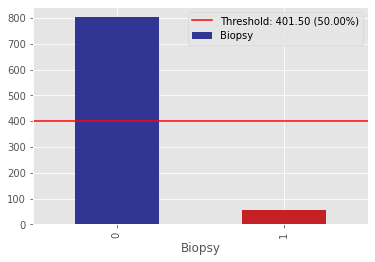

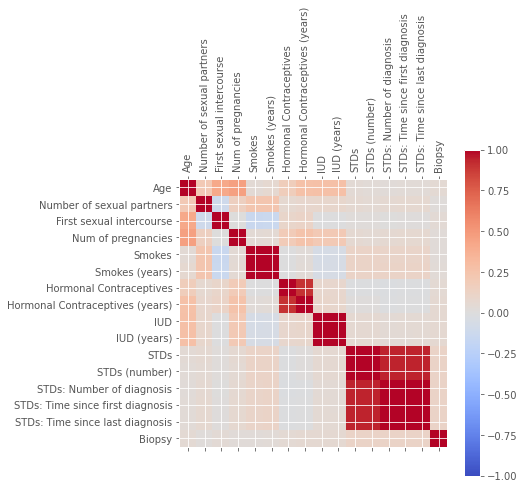

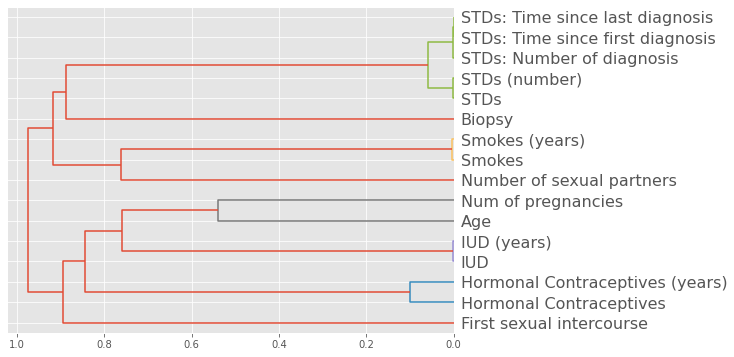

In [4]:
import xai

%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

imbalanced_cols = ['Biopsy']

xai.imbalance_plot(df, *imbalanced_cols, categorical_cols=['Biopsy'])
_ = xai.correlations(df, include_categorical=True, plot_type="matrix", plt_kwargs={'figsize': (6, 6)})
_ = xai.correlations(df, include_categorical=True, plt_kwargs={'figsize': (8, 6)})

## Target
In the cell below the target variable is selected. The **Biopsy** serves as the gold standard for diagnosing cervical cancer, therefore we will use it as target.

In [5]:
df_X, df_y, msg = split_feature_target(df, "Biopsy")
df_y

18-Oct-21 14:14:22 - Target 'Biopsy' selected successfully.


0      0
1      0
2      0
3      0
4      0
      ..
853    0
854    0
855    0
856    0
857    0
Name: Biopsy, Length: 858, dtype: int64

## Training the models
Four models are going to be trained on this dataset. In the output below we can see accuracy, classification reports, confusion matrix and ROC Curve for each model.
 * Model 1: Logistic Regression

18-Oct-21 14:14:23 - Model accuracy: 0.7945736434108527
18-Oct-21 14:14:23 - Classification report: 
              precision    recall  f1-score   support

           0       0.94      0.83      0.88       241
           1       0.11      0.29      0.16        17

    accuracy                           0.79       258
   macro avg       0.53      0.56      0.52       258
weighted avg       0.89      0.79      0.84       258



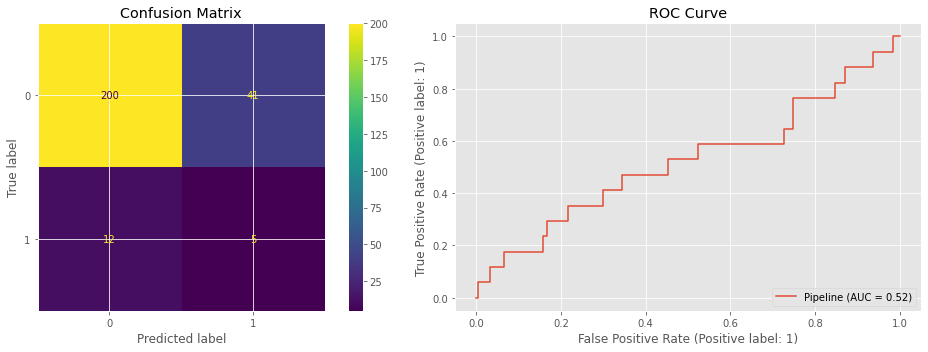

18-Oct-21 14:14:24 - Model Model 1 trained successfully!


In [6]:
# Create empty models
initial_models, msg = fill_empty_models(df_X, df_y, 4)
models = []

model1 = initial_models[0]
msg = fill_model(model1, Algorithm.LOGISTIC_REGRESSION, Split(SplitTypes.NORMAL))
models.append(model1)
model_1 = models[0]

 * Model 2: Decision Tree

18-Oct-21 14:14:24 - Model accuracy: 0.8798449612403101
18-Oct-21 14:14:24 - Classification report: 
              precision    recall  f1-score   support

           0       0.93      0.94      0.94       241
           1       0.00      0.00      0.00        17

    accuracy                           0.88       258
   macro avg       0.47      0.47      0.47       258
weighted avg       0.87      0.88      0.87       258



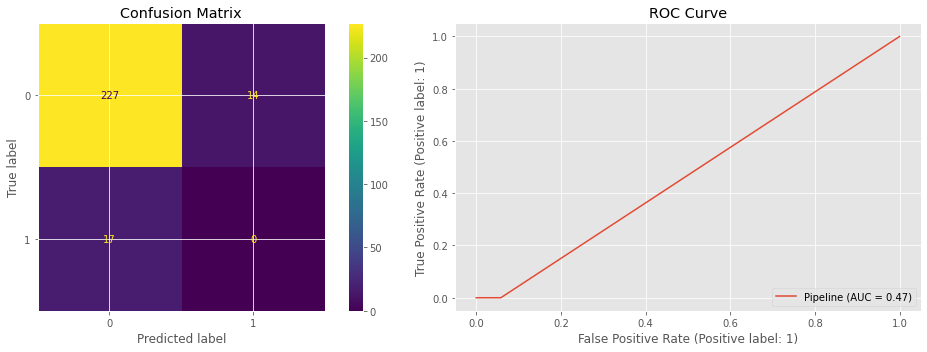

18-Oct-21 14:14:24 - Model Model 2 trained successfully!


In [7]:
model2 = initial_models[1]
msg = fill_model(model2, Algorithm.DECISION_TREE, Split(SplitTypes.NORMAL))
models.append(model2)
model_2 = models[1]

 * Model 3: Random Forest

18-Oct-21 14:14:25 - Model accuracy: 0.9031007751937985
18-Oct-21 14:14:25 - Classification report: 
              precision    recall  f1-score   support

           0       0.93      0.97      0.95       241
           1       0.00      0.00      0.00        17

    accuracy                           0.90       258
   macro avg       0.47      0.48      0.47       258
weighted avg       0.87      0.90      0.89       258



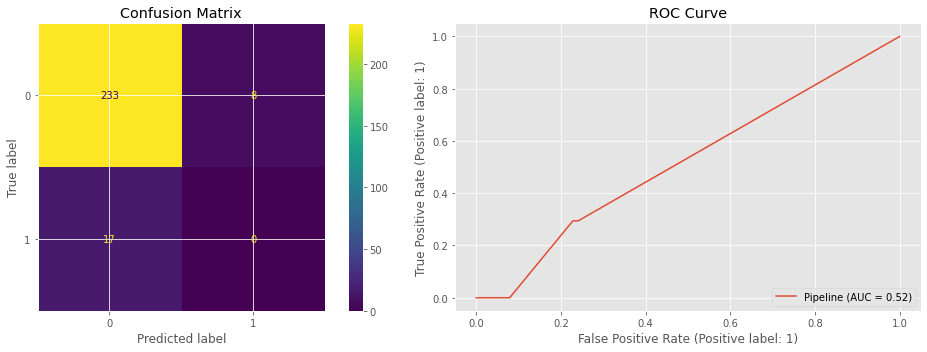

18-Oct-21 14:14:25 - Model Model 3 trained successfully!


In [8]:
model3 = initial_models[2]
msg = fill_model(model3, Algorithm.RANDOM_FOREST, Split(SplitTypes.NORMAL))
models.append(model3)
model_3 = models[2]

 * Model 4: Support Vector Machine

18-Oct-21 14:14:26 - Model accuracy: 0.8488372093023255
18-Oct-21 14:14:26 - Classification report: 
              precision    recall  f1-score   support

           0       0.95      0.88      0.92       241
           1       0.18      0.35      0.24        17

    accuracy                           0.85       258
   macro avg       0.56      0.62      0.58       258
weighted avg       0.90      0.85      0.87       258



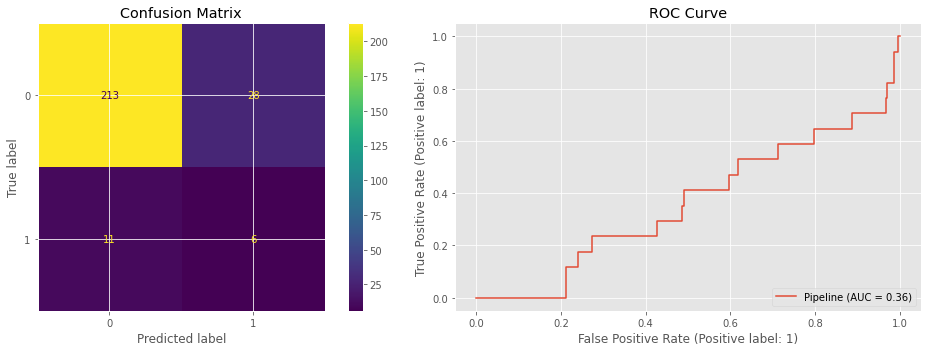

18-Oct-21 14:14:27 - Model Model 4 trained successfully!


In [9]:
model4 = initial_models[3]
msg = fill_model(model4, Algorithm.SVC, Split(SplitTypes.NORMAL))
models.append(model4)
model_4 = models[3]

## Global model interpretations
In the following steps we will use global interpretation techniques that help us to answer questions like how does a model behave in general? What features drive predictions and what features are completely useless. This data may be very important in understanding the model better. Most of the techniques work by investigating the conditional interactions between the target variable and the features on the complete dataset.

### Feature importance
The importance of a feature is the increase in the prediction error of the model after we permuted the feature’s values, which breaks the relationship between the feature and the true outcome. A feature is “important” if permuting it increases the model error. This is because in that case, the model relied heavily on this feature for making right prediction. On the other hand, a feature is “unimportant” if permuting it doesn’t affect the error by much or doesn’t change it at all.

#### ELI5
In the first case, we use [ELI5](https://github.com/TeamHG-Memex/eli5), which does not permute the features but only visualizes the weight of each feature.

 * Model 1 (Logistic Regression)

In [10]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_1)
display(plot)

18-Oct-21 14:14:27 - Generating a feature importance plot using ELI5 for Model 1 ...


Weight?,Feature
+1.000,STDs_1.0
+0.974,IUD_1.0
+0.339,STDs: Time since last diagnosis
+0.322,Hormonal Contraceptives_1.0
+0.300,<BIAS>
+0.205,Smokes_0.0
+0.095,Smokes_1.0
+0.044,First sexual intercourse
+0.031,Smokes (years)
+0.001,Number of sexual partners


 * Model 2 (Decision Tree)

In [11]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_2)
display(plot)

18-Oct-21 14:14:27 - Generating a feature importance plot using ELI5 for Model 2 ...


Weight,Feature
0.2946,Hormonal Contraceptives (years)
0.2009,Age
0.1884,First sexual intercourse
0.1317,Num of pregnancies
0.0776,Number of sexual partners
0.0403,STDs_0.0
0.0234,Smokes_0.0
0.0132,STDs: Time since first diagnosis
0.0114,IUD (years)
0.0092,Hormonal Contraceptives_1.0


 * Model 3 (Random Forest)

In [12]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_3)
display(plot)

18-Oct-21 14:14:27 - Generating a feature importance plot using ELI5 for Model 3 ...


Weight,Feature
0.1948 ± 0.0777,Age
0.1693 ± 0.0791,First sexual intercourse
0.1498 ± 0.0973,Hormonal Contraceptives (years)
0.1411 ± 0.0627,Num of pregnancies
0.1228 ± 0.0369,Number of sexual partners
0.0361 ± 0.0497,STDs (number)
0.0353 ± 0.0574,Smokes (years)
0.0268 ± 0.0575,IUD (years)
0.0262 ± 0.0586,STDs_1.0
0.0221 ± 0.0267,Hormonal Contraceptives_1.0


 * Model 4 (Support Vector Machine)

In [13]:
plot = generate_feature_importance_plot(FeatureImportanceType.ELI5, model_4)
display(plot)

18-Oct-21 14:14:27 - Generating a feature importance plot using ELI5 for Model 4 ...
18-Oct-21 14:14:27 - SVC not is supported by FeatureImportanceType.ELI5.


None

In [14]:
print(generate_feature_importance_explanation(FeatureImportanceType.ELI5, models, 4))

18-Oct-21 14:14:27 - Generating feature importance explanation for ELI5 ...
18-Oct-21 14:14:27 - SVC not supported for ELI5 explanations.


Summary:
 The highest feature for Model 1 is STDs_1.0 with weight ~1.0.
 The 2nd most influential feature for Model 1 is IUD_1.0 with weight ~0.974.
 The 3rd highest feature for Model 1 is STDs: Time since last diagnosis with weight ~0.339.
 The 4th best feature for Model 1 is Hormonal Contraceptives_1.0 with weight ~0.322.
 
 The most influential feature for Model 2 is Hormonal Contraceptives (years) with weight ~0.295.
 The 2nd highest feature for Model 2 is Age with weight ~0.201.
 The 3rd highest feature for Model 2 is First sexual intercourse with weight ~0.188.
 The 4th most influential feature for Model 2 is Num of pregnancies with weight ~0.132.
 
 The highest feature for Model 3 is Age with weight ~0.195, similar to 2nd for Model 2.
 The 2nd most valuable feature for Model 3 is First sexual intercourse with weight ~0.169, matching 3rd for Model 2.
 The 3rd most important feature for Model 3 is Hormonal Contraceptives (years) with weight ~0.15, same as 1st for Model 2.
 The 4th

#### Skater

In this step we use the [Skater](https://github.com/oracle/Skater) module, which permutes the features to generate a feature importance plot.

 * Model 1 (Logistic Regression)

18-Oct-21 14:14:27 - Generating a feature importance plot using SKATER for Model 1 ...
18-Oct-21 14:14:28 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-10-18 14:14:28,470 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

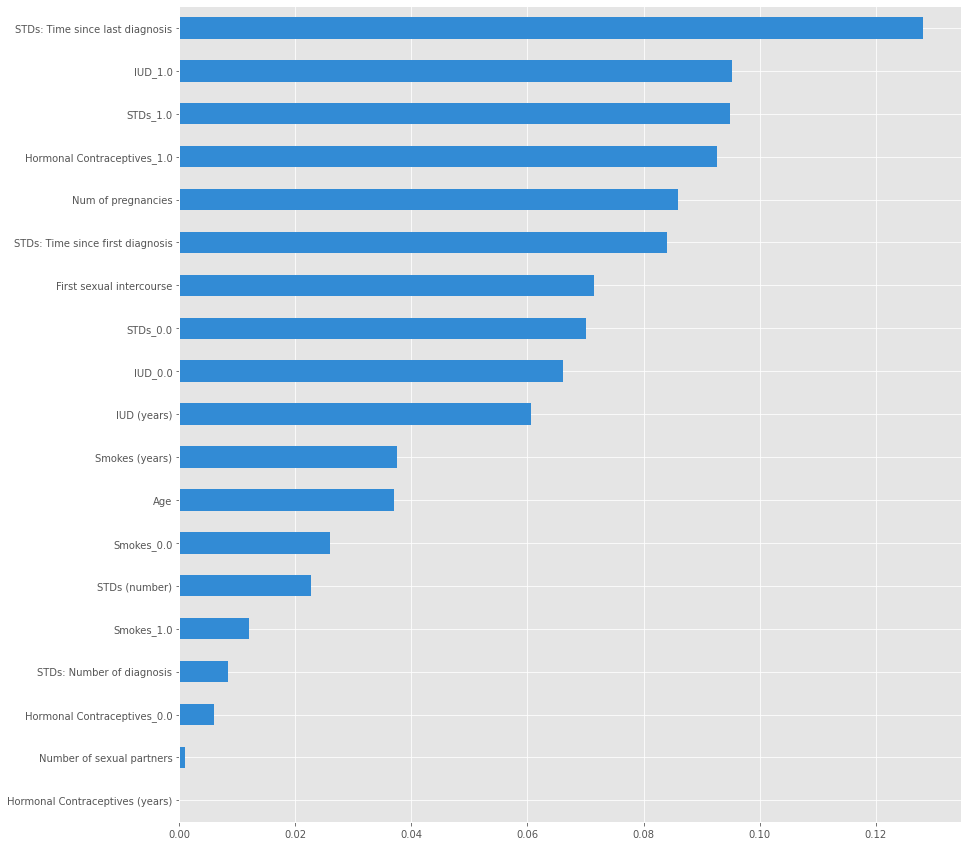

In [15]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [14, 15]
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_1)

 * Model 2 (Decision Tree)

18-Oct-21 14:14:31 - Generating a feature importance plot using SKATER for Model 2 ...
18-Oct-21 14:14:31 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-10-18 14:14:31,120 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

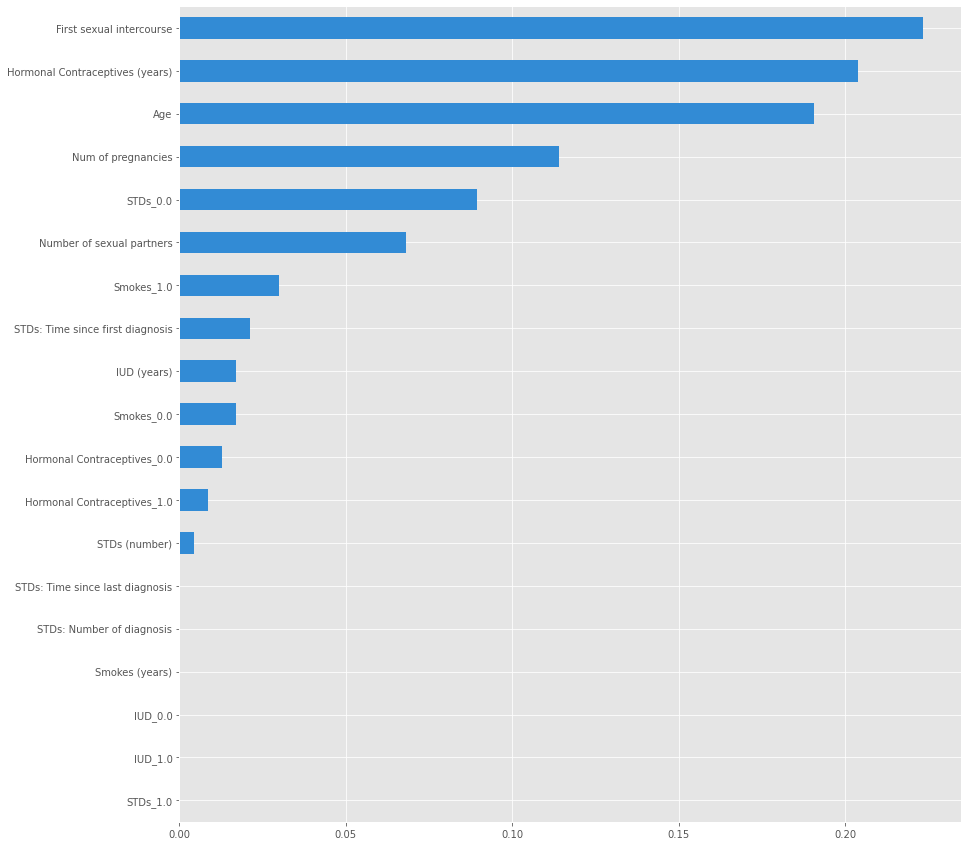

In [16]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_2)

 * Model 3 (Random Forest)

18-Oct-21 14:14:33 - Generating a feature importance plot using SKATER for Model 3 ...
18-Oct-21 14:14:33 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-10-18 14:14:33,226 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

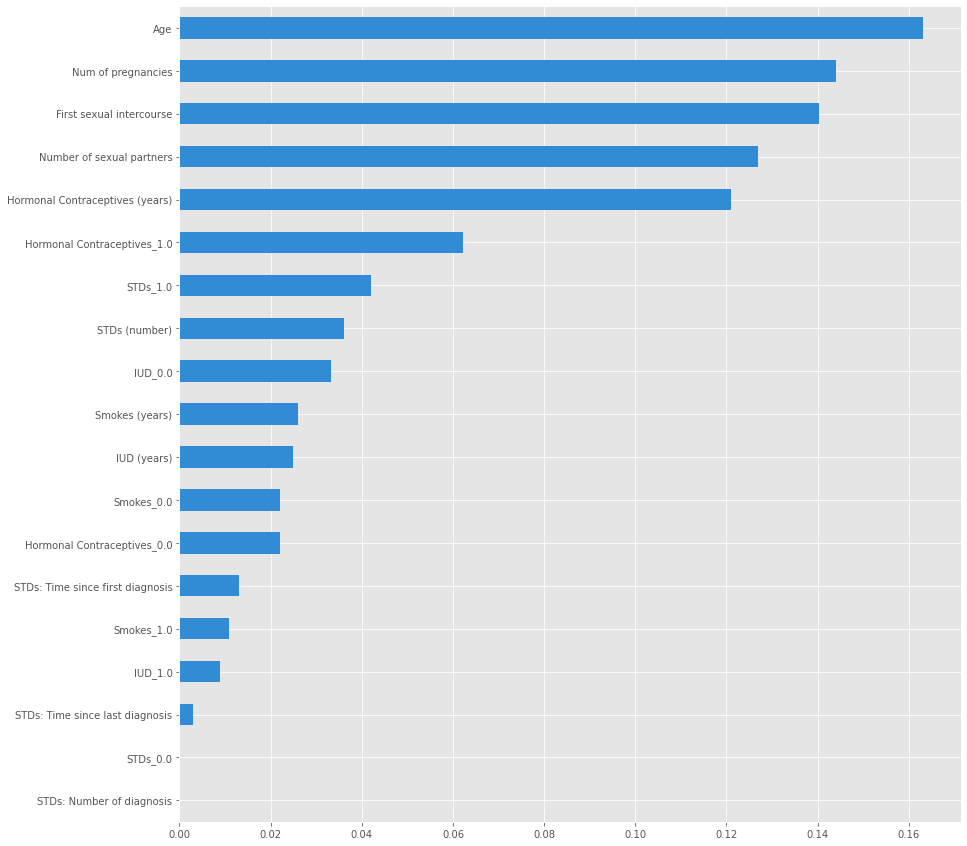

In [17]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_3)

 * Model 4 (Support Vector Machine)

18-Oct-21 14:14:35 - Generating a feature importance plot using SKATER for Model 4 ...
18-Oct-21 14:14:35 - Initializing Skater - generating new in-memory model. This operation may be time-consuming so please be patient.
2021-10-18 14:14:36,083 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

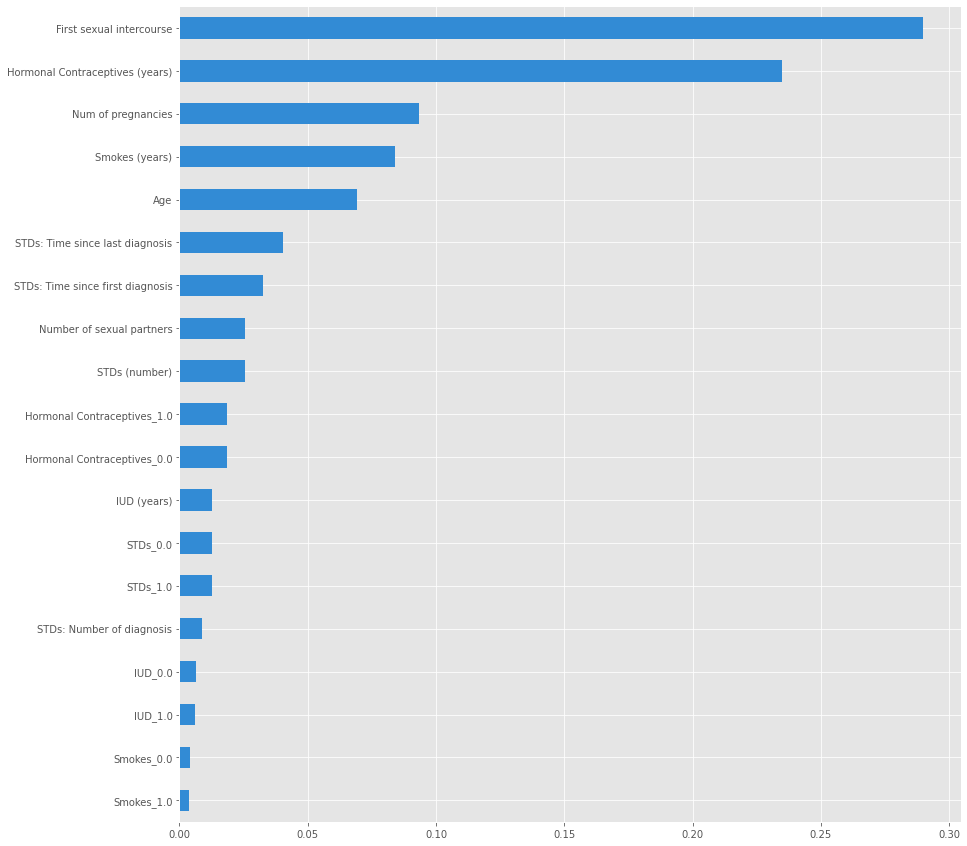

In [18]:
_ = generate_feature_importance_plot(FeatureImportanceType.SKATER, model_4)

In [19]:
print('\n' + generate_feature_importance_explanation(FeatureImportanceType.SKATER, models, 4))

18-Oct-21 14:14:38 - Generating feature importance explanation for SKATER ...
2021-10-18 14:14:38,706 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

2021-10-18 14:14:40,613 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

2021-10-18 14:14:41,900 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds

2021-10-18 14:14:43,381 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progress_bar=False


[19/19] features ████████████████████ Time elapsed: 1 seconds
Summary:
 The most influential feature for Model 1 is STDs: Time since last diagnosis with weight ~0.118.
 The 2nd best feature for Model 1 is Num of pregnancies with weight ~0.093.
 The 3rd most important feature for Model 1 is Hormonal Contraceptives_1.0 with weight ~0.091.
 The 4th best feature for Model 1 is STDs: Time since first diagnosis with weight ~0.085.
 
 The most important feature for Model 2 is Hormonal Contraceptives (years) with weight ~0.239.
 The 2nd highest feature for Model 2 is First sexual intercourse with weight ~0.192.
 The 3rd highest feature for Model 2 is Age with weight ~0.172.
 The 4th most influential feature for Model 2 is Num of pregnancies with weight ~0.122, matching 2nd for Model 1.
 
 The best feature for Model 3 is First sexual intercourse with weight ~0.155, alike 2nd for Model 2.
 The 2nd most valuable feature for Model 3 is Number of sexual partners with weight ~0.152.
 The 3rd best fe

#### Shap

In the cell below we use the [SHAP](https://github.com/slundberg/shap) (SHapley Additive exPlanations). It uses a combination of feature contributions and game theory to come up with SHAP values. Then, it computes the global feature importance by taking the average of the SHAP value magnitudes across the dataset.

 * Model 1 (Logistic Regression)

18-Oct-21 14:14:45 - Generating a feature importance plot using SHAP for Model 1 ...
18-Oct-21 14:14:45 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/258 [00:00<?, ?it/s]

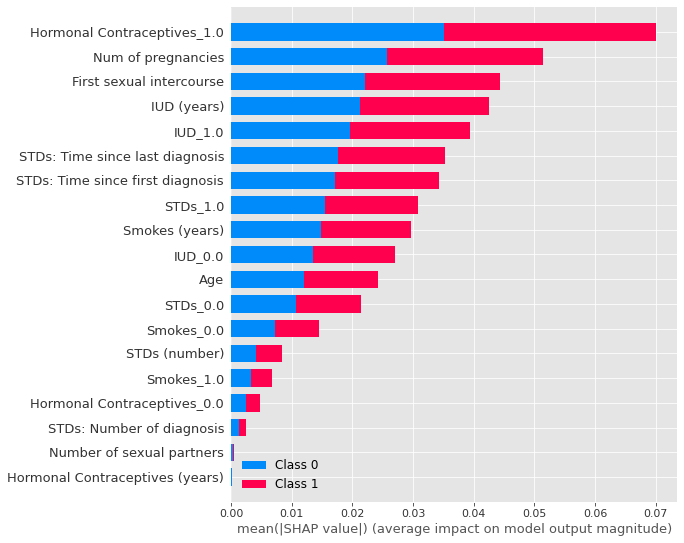

In [20]:
from shap import initjs
initjs()

%matplotlib inline
plt.style.use('ggplot')
warnings.filterwarnings('ignore')

generate_feature_importance_plot(FeatureImportanceType.SHAP, model_1)

 * Model 2 (Decision Tree)

18-Oct-21 14:14:57 - Generating a feature importance plot using SHAP for Model 2 ...
18-Oct-21 14:14:57 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/258 [00:00<?, ?it/s]

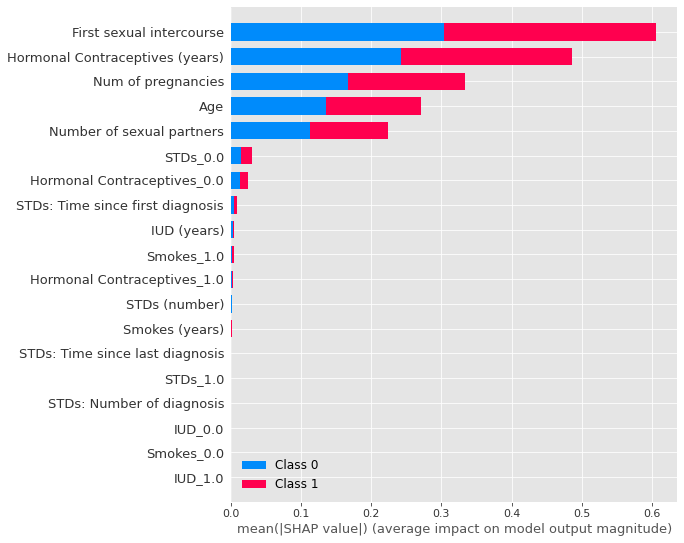

In [21]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_2)

 * Model 3 (Random Forest)

18-Oct-21 14:15:08 - Generating a feature importance plot using SHAP for Model 3 ...
18-Oct-21 14:15:08 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/258 [00:00<?, ?it/s]

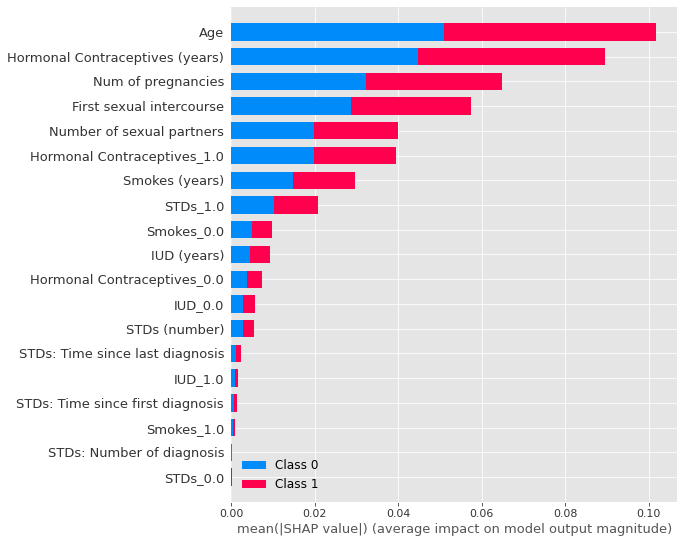

In [22]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_3)

 * Model 4 (Support Vector Machine)

18-Oct-21 14:15:25 - Generating a feature importance plot using SHAP for Model 4 ...
18-Oct-21 14:15:25 - Initializing Shap - calculating shap values. This operation is time-consuming so please be patient.


  0%|          | 0/258 [00:00<?, ?it/s]

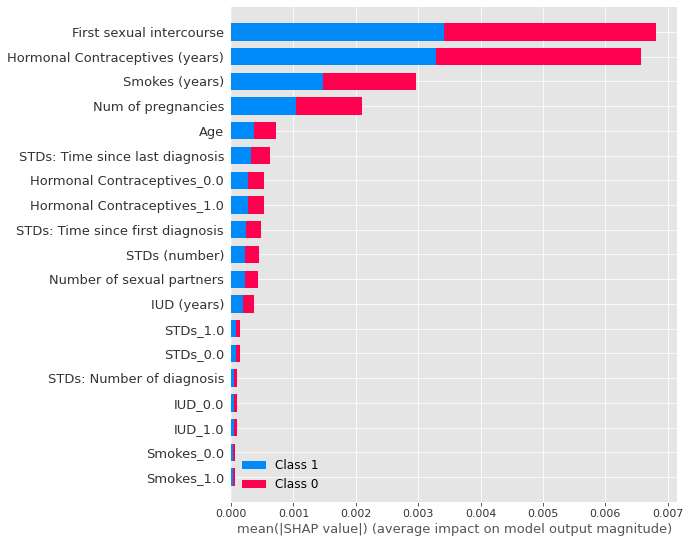

In [23]:
generate_feature_importance_plot(FeatureImportanceType.SHAP, model_4)

In [24]:
print(generate_feature_importance_explanation(FeatureImportanceType.SHAP, models, 4))

18-Oct-21 14:15:59 - Generating feature importance explanation for SHAP ...


Summary:
 The best feature for Model 1 is Hormonal Contraceptives_1.0 with weight ~0.07.
 The 2nd most important feature for Model 1 is Num of pregnancies with weight ~0.051.
 The 3rd most valuable feature for Model 1 is First sexual intercourse with weight ~0.044.
 The 4th highest feature for Model 1 is IUD (years) with weight ~0.043.
 
 The most important feature for Model 2 is First sexual intercourse with weight ~0.606, similar to 3rd for Model 1.
 The 2nd most influential feature for Model 2 is Hormonal Contraceptives (years) with weight ~0.486.
 The 3rd most valuable feature for Model 2 is Num of pregnancies with weight ~0.333, similar to 2nd for Model 1.
 The 4th best feature for Model 2 is Age with weight ~0.272.
 
 The best feature for Model 3 is Age with weight ~0.102, identical to 4th for Model 2.
 The 2nd best feature for Model 3 is Hormonal Contraceptives (years) with weight ~0.089, alike 2nd for Model 2.
 The 3rd most valuable feature for Model 3 is Num of pregnancies wit

### Partial Dependence Plots
The partial dependence plot (short PDP or PD plot) shows the marginal effect one or two features have on the predicted outcome of a machine learning model. A partial dependence plot can show whether the relationship between the target and a feature is linear, monotonic or more complex. For example, when applied to a linear regression model, partial dependence plots always show a linear relationship.

#### PDPBox

[PDPBox](https://github.com/SauceCat/PDPbox) is the first module that we use for ploting partial dependence.

 * Model 1 (Logistic Regression)

18-Oct-21 14:15:59 - Generating a PDP plot using PDPBox for Model 1 ...
18-Oct-21 14:15:59 - Generating a PDP plot using PDPBox for Model 1 ...


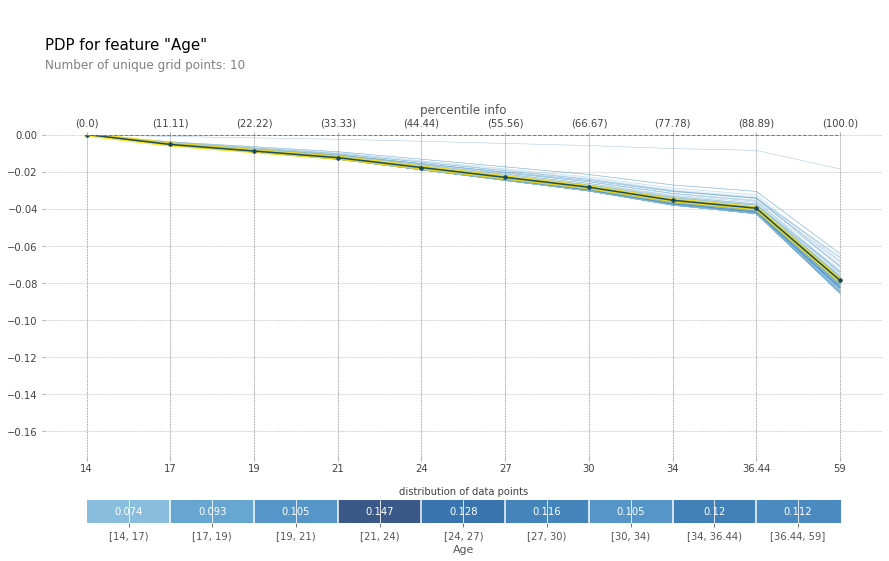

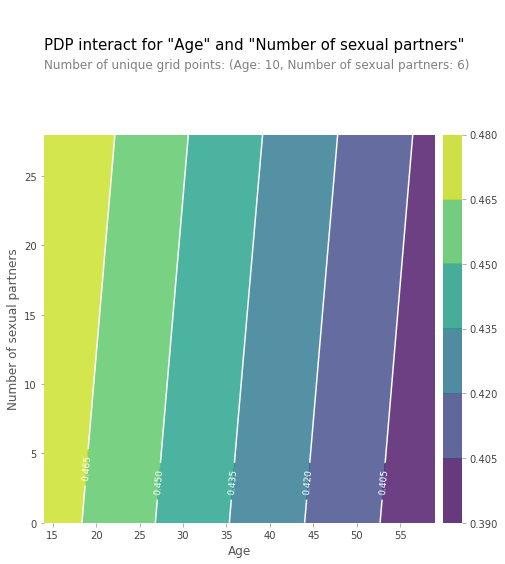

In [25]:
generate_pdp_plots(PDPType.PDPBox, model_1, "Age", "None")
generate_pdp_plots(PDPType.PDPBox, model_1, "Age", "Number of sexual partners")

 * Model 2 (Decision Tree)

18-Oct-21 14:16:02 - Generating a PDP plot using PDPBox for Model 2 ...
18-Oct-21 14:16:03 - Generating a PDP plot using PDPBox for Model 2 ...


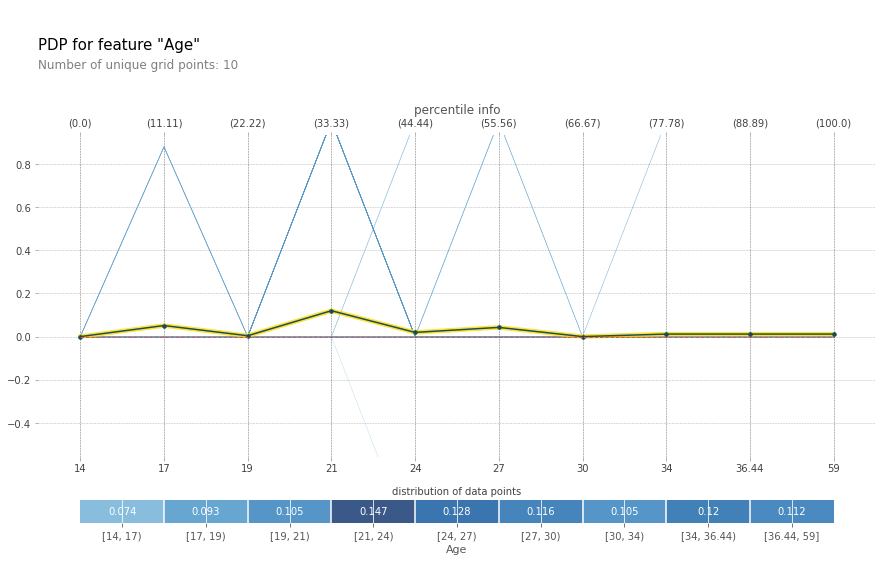

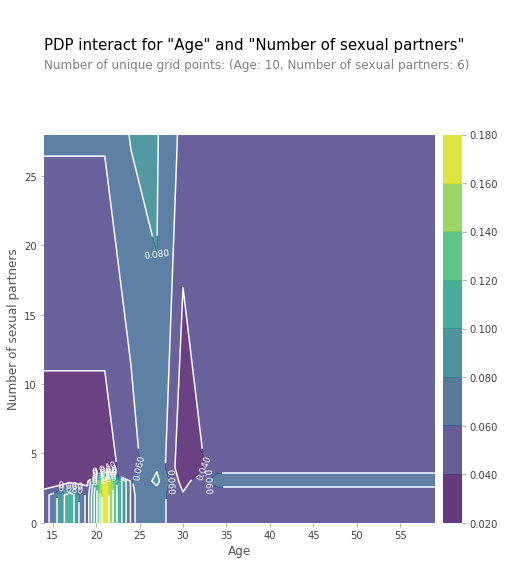

In [26]:
generate_pdp_plots(PDPType.PDPBox, model_2, "Age", "None")
generate_pdp_plots(PDPType.PDPBox, model_2, "Age", "Number of sexual partners")

 * Model 3 (Random Forest)

18-Oct-21 14:16:06 - Generating a PDP plot using PDPBox for Model 3 ...
18-Oct-21 14:16:07 - Generating a PDP plot using PDPBox for Model 3 ...


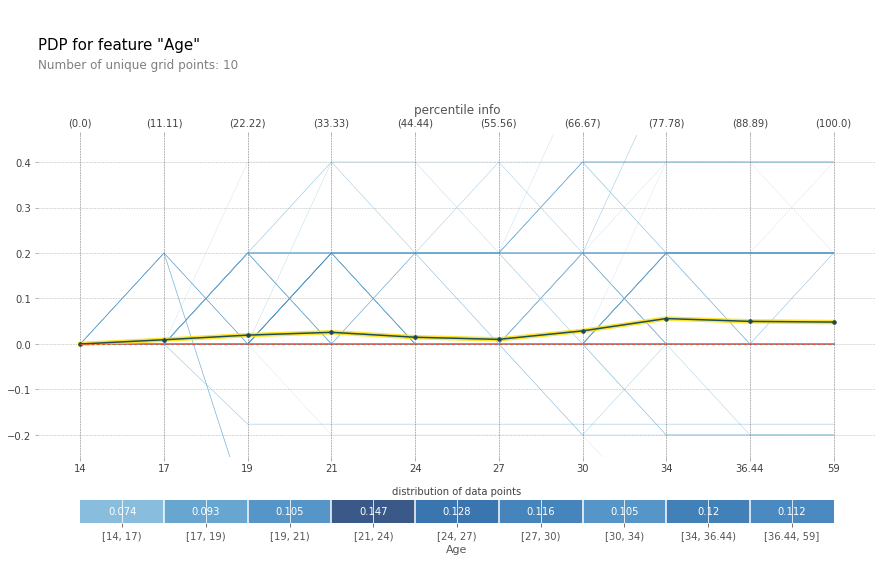

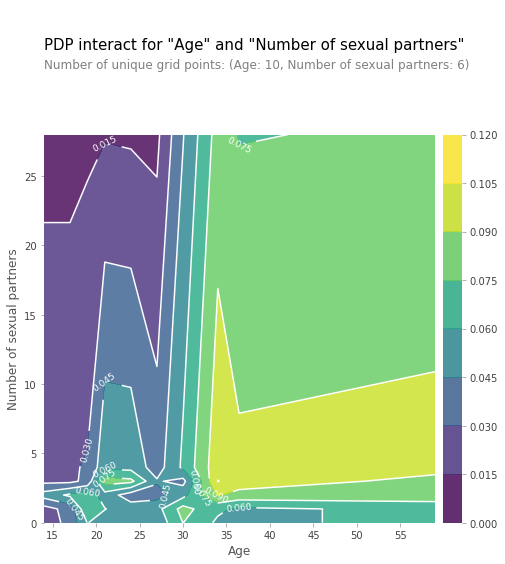

In [27]:
generate_pdp_plots(PDPType.PDPBox, model_3, "Age", "None")
generate_pdp_plots(PDPType.PDPBox, model_3, "Age", "Number of sexual partners")

 * Model 4 (Support Vector Machine)

18-Oct-21 14:16:11 - Generating a PDP plot using PDPBox for Model 4 ...
18-Oct-21 14:16:12 - Generating a PDP plot using PDPBox for Model 4 ...


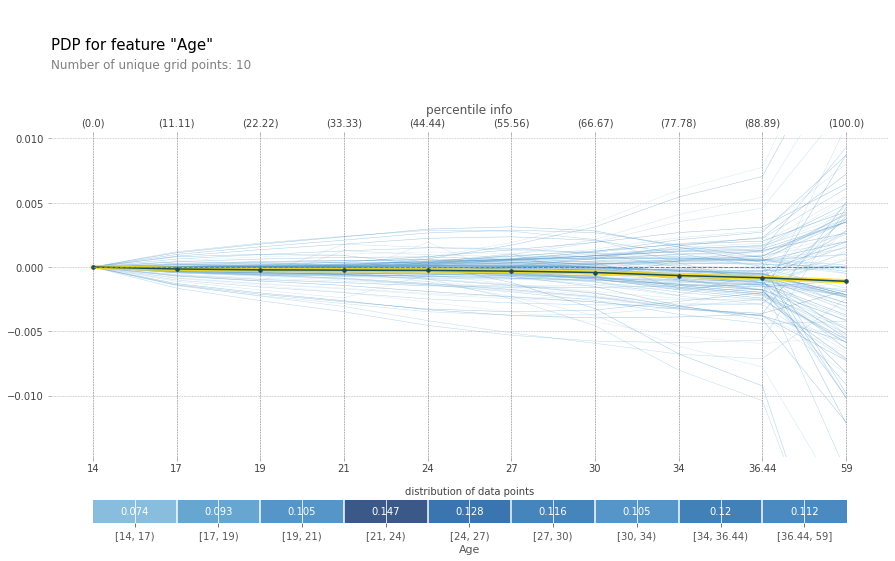

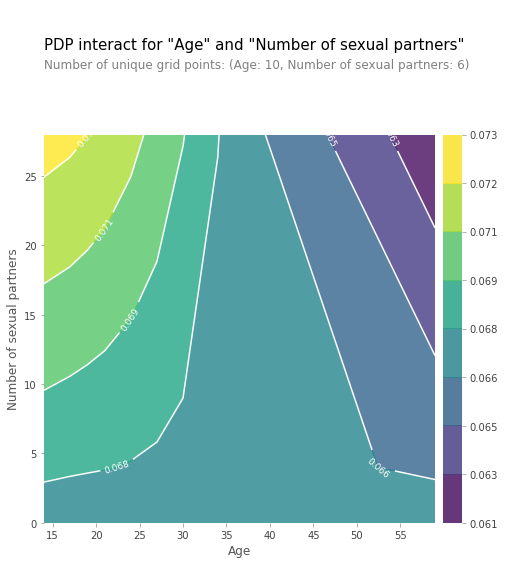

In [28]:
generate_pdp_plots(PDPType.PDPBox, model_4, "Age", "None")
generate_pdp_plots(PDPType.PDPBox, model_4, "Age", "Number of sexual partners")

#### Skater
 * Model 1 (Logistic Regression)

18-Oct-21 14:16:18 - Generating a PDP plot using SKATER for Model 1 ...
2021-10-18 14:16:19,232 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[504/504] grid cells ████████████████████ Time elapsed: 77 seconds

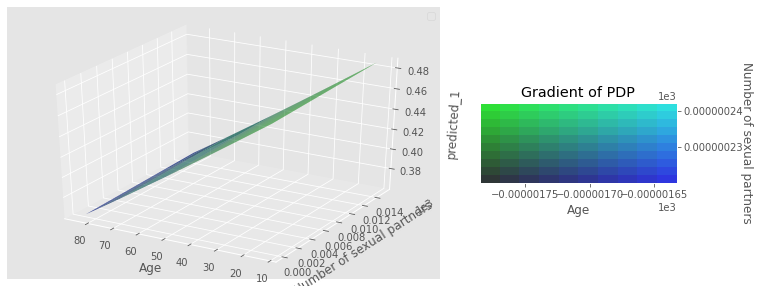

In [29]:
generate_pdp_plots(PDPType.SKATER, model_1, "Age", "Number of sexual partners")

 * Model 2 (Decision Tree)

18-Oct-21 14:17:37 - Generating a PDP plot using SKATER for Model 2 ...
2021-10-18 14:17:38,242 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[504/504] grid cells ████████████████████ Time elapsed: 77 seconds

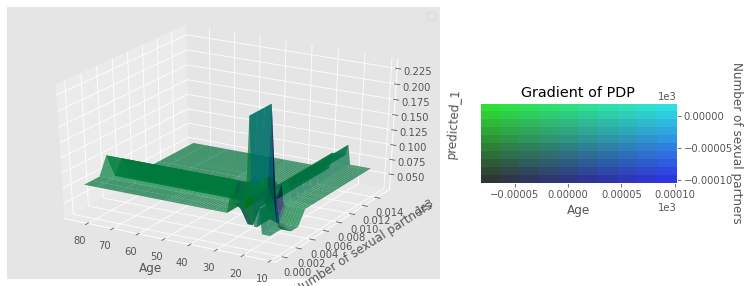

In [30]:
generate_pdp_plots(PDPType.SKATER, model_2, "Age", "Number of sexual partners")

 * Model 3 (Random Forest)

18-Oct-21 14:18:56 - Generating a PDP plot using SKATER for Model 3 ...
2021-10-18 14:18:57,288 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[504/504] grid cells ████████████████████ Time elapsed: 91 seconds

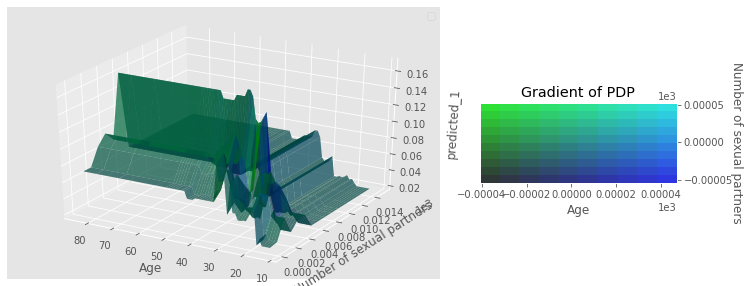

In [31]:
generate_pdp_plots(PDPType.SKATER, model_3, "Age", "Number of sexual partners")

 * Model 4 (Support Vector Machine)

18-Oct-21 14:20:30 - Generating a PDP plot using SKATER for Model 4 ...
2021-10-18 14:20:30,454 - skater.core.explanations - WARNING - Progress bars slow down runs by 10-20%. For slightly 
faster runs, do progressbar=False


[504/504] grid cells ████████████████████ Time elapsed: 138 seconds

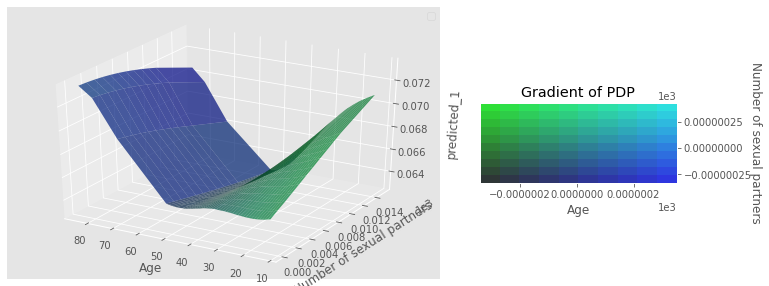

In [32]:
generate_pdp_plots(PDPType.SKATER, model_4, "Age", "Number of sexual partners")

#### SHAP
 * Model 1 (Logistic Regression)

18-Oct-21 14:22:50 - Generating a PDP plot using SHAP for Model 1 ...


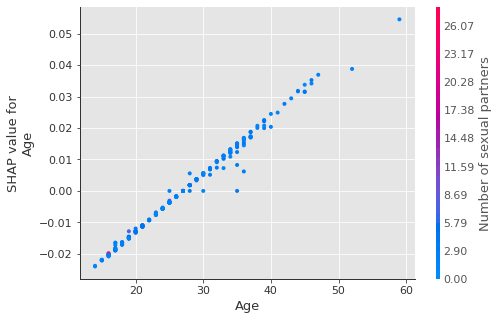

In [33]:
generate_pdp_plots(PDPType.SHAP, model_1, "Age", "Number of sexual partners")

 * Model 2 (Decision Tree)

18-Oct-21 14:22:51 - Generating a PDP plot using SHAP for Model 2 ...


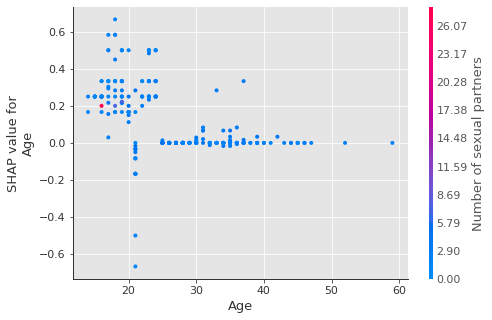

In [34]:
generate_pdp_plots(PDPType.SHAP, model_2, "Age", "Number of sexual partners")

 * Model 3 (Random Forest)

18-Oct-21 14:22:51 - Generating a PDP plot using SHAP for Model 3 ...


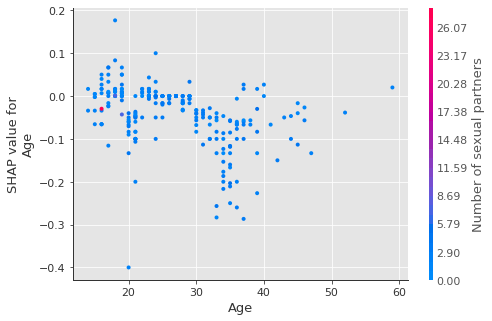

In [35]:
generate_pdp_plots(PDPType.SHAP, model_3, "Age", "Number of sexual partners")

 * Model 4 (Support Vector Machine)

18-Oct-21 14:22:52 - Generating a PDP plot using SHAP for Model 4 ...


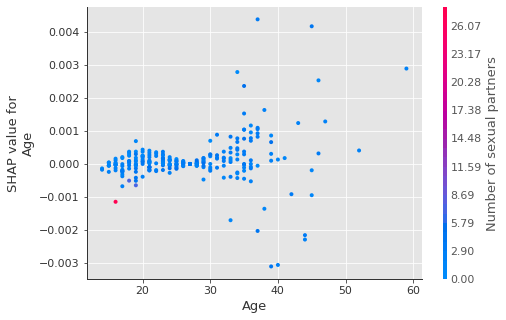

In [36]:
generate_pdp_plots(PDPType.SHAP, model_4, "Age", "Number of sexual partners")

## Local model interpretations
Local interpretation focuses on specifics of each individual and provides explanations that can lead to a better understanding of the feature contribution in smaller groups of individuals that are often overlooked by the global interpretation techniques. We will use two moduels for interpreting single instances - SHAP and LIME.

#### SHAP
SHAP leverages the idea of Shapley values for model feature influence scoring. The technical definition of a Shapley value is the “average marginal contribution of a feature value over all possible coalitions.” In other words, Shapley values consider all possible predictions for an instance using all possible combinations of inputs. Because of this exhaustive approach, SHAP can guarantee properties like consistency and local accuracy. LIME, on the other hand, does not offer such guarantees.

#### LIME
[LIME](https://github.com/marcotcr/lime) (Local Interpretable Model-agnostic Explanations) builds sparse linear models around each prediction to explain how the black box model works in that local vicinity. While treating the model as a black box, we perturb the instance we want to explain and learn a sparse linear model around it, as an explanation. LIME has the advantage over *SHAP*, that it is a lot faster.



In [37]:
examples = []
example_types = [ExampleType.FALSELY_CLASSIFIED]
for example_type in example_types:
    for model in models:
        example = get_test_examples(model, example_type, 1)[0]
        while example in examples:
            example = get_test_examples(model, example_type, 1)[0]
        examples.append(example)
display(examples)

[185, 91, 22, 32]

##### Example 1

In [38]:
example = examples[0]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 185's data: 
Age                                   29
Number of sexual partners            4.0
First sexual intercourse            18.0
Num of pregnancies                   0.0
Smokes                               0.0
Smokes (years)                       0.0
Hormonal Contraceptives              1.0
Hormonal Contraceptives (years)     0.75
IUD                                  0.0
IUD (years)                          0.0
STDs                                 0.0
STDs (number)                        0.0
STDs: Number of diagnosis              0
STDs: Time since first diagnosis     0.0
STDs: Time since last diagnosis      0.0
Name: 695, dtype: object
Actual result for example 185: 0

Example 185 was truly classified by Model 2, Model 3, Model 4 and falsely classified by Model 1.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [39]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

18-Oct-21 14:22:52 - Generating a single instance explanation using LIME for Model 1 ...
18-Oct-21 14:22:52 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
18-Oct-21 14:23:00 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.51. LIME's explanation: 
The feature that largely changes Model 1's positive (1) prediction probability is STDs: Time since first diagnosis <= 0.00 with value of 0.3091.
The feature with the second most substantial change on Model 1's positive (1) prediction probability is IUD (years) <= 0.00 with value of 0.1243.
The third most effective feature for the positive (1) prediction probability of Model 1 is Hormonal Contraceptives=1.0 with value of 0.0704
The feature that mostly changes Model 1's negative (0) prediction probability is STDs: Time since last diagnosis <= 0.00 with value of -0.3559.
The feature with the second most considerable affect on Model 1's negative (0) prediction probability is STDs=0.0 with value of -0.3319.




18-Oct-21 14:23:07 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.51. SHAP's explanation: 
The feature that mostly influences Model 1's positive (1) prediction probability is Num of pregnancies with value of 0.0516.
The feature with the second largest influence on Model 1's positive (1) prediction probability is IUD (years) with value of 0.0122.
The third most important feature for the positive (1) prediction probability of Model 1 is First sexual intercourse with value of 0.0108
The feature that primarily impacts Model 1's negative (0) prediction probability is Smokes (years) with value of -0.0096.
The feature with the second most substantial influence on Model 1's negative (0) prediction probability is Age with value of -0.0038.




 * Model 2 (Decision Tree)

In [40]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

18-Oct-21 14:23:07 - Generating a single instance explanation using LIME for Model 2 ...
18-Oct-21 14:23:07 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
18-Oct-21 14:23:15 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that primarily changes Model 2's positive (1) prediction probability is 0.16 < Hormonal Contraceptives (years) <= 2.00 with value of 0.0804.
The feature with the second most considerable influence on Model 2's positive (1) prediction probability is Num of pregnancies <= 1.00 with value of 0.066.
The third most influential feature for the positive (1) prediction probability of Model 2 is 16.00 < First sexual intercourse <= 18.00 with value of 0.0369
The feature that primarily influences Model 2's negative (0) prediction probability is STDs=0.0 with value of -0.1297.
The feature with the second most substantial impact on Model 2's negative (0) prediction probability is Smokes=0.0 with value of -0.0795.




18-Oct-21 14:23:22 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that primarily affects Model 2's positive (1) prediction probability is Number of sexual partners with value of 0.25.
The feature with the second largest impact on Model 2's positive (1) prediction probability is First sexual intercourse with value of 0.25.
The third most influential feature for the positive (1) prediction probability of Model 2 is Num of pregnancies with value of 0.25




 * Model 3 (Random Forest)

In [41]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

18-Oct-21 14:23:22 - Generating a single instance explanation using LIME for Model 3 ...
18-Oct-21 14:23:22 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
18-Oct-21 14:23:29 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 1.0. LIME's explanation: 
The feature that mainly affects Model 3's positive (1) prediction probability is Hormonal Contraceptives=1.0 with value of 0.0279.
The feature with the second most substantial affect on Model 3's positive (1) prediction probability is IUD (years) <= 0.00 with value of 0.0148.
The third most important feature for the positive (1) prediction probability of Model 3 is 0.16 < Hormonal Contraceptives (years) <= 2.00 with value of 0.0134
The feature that largely changes Model 3's negative (0) prediction probability is STDs=0.0 with value of -0.0652.
The feature with the second most substantial impact on Model 3's negative (0) prediction probability is STDs (number) <= 0.00 with value of -0.0509.




18-Oct-21 14:23:36 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 1.0. SHAP's explanation: 
The feature that mainly changes Model 3's positive (1) prediction probability is Age with value of 0.0333.
The feature with the second biggest impact on Model 3's positive (1) prediction probability is Number of sexual partners with value of 0.0333.
The feature that primarily impacts Model 3's negative (0) prediction probability is Num of pregnancies with value of -0.0667.




 * Model 4 (Support Vector Machine)

In [42]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

18-Oct-21 14:23:37 - Generating a single instance explanation using LIME for Model 4 ...
18-Oct-21 14:23:37 - Initializing LIME - generating new explainer. This operation may be time-consuming so please be patient.
18-Oct-21 14:23:45 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.94. LIME's explanation: 
The feature that mostly influences Model 4's positive (1) prediction probability is STDs: Time since last diagnosis <= 0.00 with value of 0.0076.
The feature with the second most substantial influence on Model 4's positive (1) prediction probability is STDs: Time since first diagnosis <= 0.00 with value of 0.0043.
The third most effective feature for the positive (1) prediction probability of Model 4 is STDs (number) <= 0.00 with value of 0.0037
The feature that primarily affects Model 4's negative (0) prediction probability is Smokes (years) <= 0.00 with value of -0.0054.
The feature with the second most considerable change on Model 4's negative (0) prediction probability is 16.00 < First sexual intercourse <= 18.00 with value of -0.003.




18-Oct-21 14:23:54 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.94. SHAP's explanation: 
The feature that mainly impacts Model 4's positive (1) prediction probability is Num of pregnancies with value of 0.0021.
The feature with the second most considerable influence on Model 4's positive (1) prediction probability is First sexual intercourse with value of 0.0017.
The third most impactful feature for the positive (1) prediction probability of Model 4 is Smokes (years) with value of 0.0011
The feature that primarily affects Model 4's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.0018.
The feature with the second largest influence on Model 4's negative (0) prediction probability is Number of sexual partners with value of -0.0004.




##### Example 2

In [43]:
example = examples[1]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 91's data: 
Age                                   21
Number of sexual partners            1.0
First sexual intercourse            18.0
Num of pregnancies                   2.0
Smokes                               0.0
Smokes (years)                       0.0
Hormonal Contraceptives              0.0
Hormonal Contraceptives (years)      0.0
IUD                                  0.0
IUD (years)                          0.0
STDs                                 0.0
STDs (number)                        0.0
STDs: Number of diagnosis              0
STDs: Time since first diagnosis     0.0
STDs: Time since last diagnosis      0.0
Name: 297, dtype: object
Actual result for example 91: 0

Example 91 was truly classified by Model 1, Model 3, Model 4 and falsely classified by Model 2.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [44]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

18-Oct-21 14:23:54 - Generating a single instance explanation using LIME for Model 1 ...
18-Oct-21 14:24:02 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.62. LIME's explanation: 
The feature that primarily influences Model 1's positive (1) prediction probability is STDs: Time since first diagnosis <= 0.00 with value of 0.3139.
The feature with the second largest change on Model 1's positive (1) prediction probability is IUD (years) <= 0.00 with value of 0.1276.
The third most influential feature for the positive (1) prediction probability of Model 1 is STDs (number) <= 0.00 with value of 0.0555
The feature that mostly impacts Model 1's negative (0) prediction probability is STDs: Time since last diagnosis <= 0.00 with value of -0.3682.
The feature with the second most considerable impact on Model 1's negative (0) prediction probability is STDs=0.0 with value of -0.343.




18-Oct-21 14:24:09 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.62. SHAP's explanation: 
The feature that mainly influences Model 1's positive (1) prediction probability is Hormonal Contraceptives_1.0 with value of 0.078.
The feature with the second biggest affect on Model 1's positive (1) prediction probability is Smokes (years) with value of 0.0094.
The third most influential feature for the positive (1) prediction probability of Model 1 is Hormonal Contraceptives_0.0 with value of 0.0054
The feature that largely impacts Model 1's negative (0) prediction probability is IUD (years) with value of -0.0119.
The feature with the second largest affect on Model 1's negative (0) prediction probability is Age with value of -0.011.




 * Model 2 (Decision Tree)

In [45]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

18-Oct-21 14:24:09 - Generating a single instance explanation using LIME for Model 2 ...
18-Oct-21 14:24:16 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that primarily impacts Model 2's positive (1) prediction probability is 16.00 < First sexual intercourse <= 18.00 with value of 0.0538.
The feature with the second most substantial influence on Model 2's positive (1) prediction probability is 20.00 < Age <= 25.00 with value of 0.0266.
The third most influential feature for the positive (1) prediction probability of Model 2 is IUD=0.0 with value of 0.014
The feature that primarily impacts Model 2's negative (0) prediction probability is STDs=0.0 with value of -0.1357.
The feature with the second most substantial change on Model 2's negative (0) prediction probability is Hormonal Contraceptives (years) <= 0.00 with value of -0.075.




18-Oct-21 14:24:24 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that mainly changes Model 2's positive (1) prediction probability is Age with value of 0.6667.
The feature that mostly impacts Model 2's negative (0) prediction probability is First sexual intercourse with value of -0.3333.
The feature with the second most substantial affect on Model 2's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.3333.




 * Model 3 (Random Forest)

In [46]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

18-Oct-21 14:24:24 - Generating a single instance explanation using LIME for Model 3 ...
18-Oct-21 14:24:31 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 1.0. LIME's explanation: 
The feature that mostly impacts Model 3's positive (1) prediction probability is 1.00 < Num of pregnancies <= 2.00 with value of 0.0192.
The feature with the second most considerable affect on Model 3's positive (1) prediction probability is 16.00 < First sexual intercourse <= 18.00 with value of 0.0142.
The third most impactful feature for the positive (1) prediction probability of Model 3 is 20.00 < Age <= 25.00 with value of 0.0067
The feature that largely impacts Model 3's negative (0) prediction probability is STDs=0.0 with value of -0.0806.
The feature with the second largest change on Model 3's negative (0) prediction probability is STDs (number) <= 0.00 with value of -0.0526.




18-Oct-21 14:24:39 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 1.0. SHAP's explanation: 
The feature that mainly changes Model 3's positive (1) prediction probability is Hormonal Contraceptives_1.0 with value of 0.1167.
The feature with the second largest impact on Model 3's positive (1) prediction probability is Number of sexual partners with value of 0.0167.
The feature that mostly changes Model 3's negative (0) prediction probability is Age with value of -0.0833.
The feature with the second largest impact on Model 3's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.05.




 * Model 4 (Support Vector Machine)

In [47]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

18-Oct-21 14:24:39 - Generating a single instance explanation using LIME for Model 4 ...
18-Oct-21 14:24:47 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.93. LIME's explanation: 
The feature that primarily impacts Model 4's positive (1) prediction probability is STDs: Time since last diagnosis <= 0.00 with value of 0.0072.
The feature with the second largest affect on Model 4's positive (1) prediction probability is STDs: Time since first diagnosis <= 0.00 with value of 0.0055.
The third most effective feature for the positive (1) prediction probability of Model 4 is Hormonal Contraceptives (years) <= 0.00 with value of 0.0053
The feature that primarily influences Model 4's negative (0) prediction probability is Smokes (years) <= 0.00 with value of -0.005.
The feature with the second biggest change on Model 4's negative (0) prediction probability is 16.00 < First sexual intercourse <= 18.00 with value of -0.0029.




18-Oct-21 14:24:56 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.93. SHAP's explanation: 
The feature that primarily influences Model 4's positive (1) prediction probability is First sexual intercourse with value of 0.0019.
The feature with the second largest influence on Model 4's positive (1) prediction probability is Smokes (years) with value of 0.001.
The third most important feature for the positive (1) prediction probability of Model 4 is Age with value of 0.0003
The feature that mainly influences Model 4's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.0027.
The feature with the second biggest influence on Model 4's negative (0) prediction probability is Hormonal Contraceptives_1.0 with value of -0.0006.




##### Example 3

In [48]:
example = examples[2]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 22's data: 
Age                                   21
Number of sexual partners            5.0
First sexual intercourse            16.0
Num of pregnancies                   1.0
Smokes                               0.0
Smokes (years)                       0.0
Hormonal Contraceptives              1.0
Hormonal Contraceptives (years)     0.42
IUD                                  0.0
IUD (years)                          0.0
STDs                                 0.0
STDs (number)                        0.0
STDs: Number of diagnosis              0
STDs: Time since first diagnosis     0.0
STDs: Time since last diagnosis      0.0
Name: 258, dtype: object
Actual result for example 22: 0

Example 22 was truly classified by Model 1, Model 2, Model 4 and falsely classified by Model 3.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [49]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

18-Oct-21 14:24:56 - Generating a single instance explanation using LIME for Model 1 ...
18-Oct-21 14:25:03 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.53. LIME's explanation: 
The feature that mostly changes Model 1's positive (1) prediction probability is STDs: Time since first diagnosis <= 0.00 with value of 0.3182.
The feature with the second most considerable change on Model 1's positive (1) prediction probability is IUD (years) <= 0.00 with value of 0.1286.
The third most influential feature for the positive (1) prediction probability of Model 1 is Hormonal Contraceptives=1.0 with value of 0.0732
The feature that mostly affects Model 1's negative (0) prediction probability is STDs: Time since last diagnosis <= 0.00 with value of -0.3595.
The feature with the second most considerable affect on Model 1's negative (0) prediction probability is STDs=0.0 with value of -0.3422.




18-Oct-21 14:25:11 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.53. SHAP's explanation: 
The feature that mostly affects Model 1's positive (1) prediction probability is First sexual intercourse with value of 0.0108.
The feature with the second most considerable change on Model 1's positive (1) prediction probability is Smokes (years) with value of 0.0096.
The feature that primarily impacts Model 1's negative (0) prediction probability is Num of pregnancies with value of -0.0257.
The feature with the second biggest affect on Model 1's negative (0) prediction probability is IUD (years) with value of -0.0122.




 * Model 2 (Decision Tree)

In [50]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

18-Oct-21 14:25:11 - Generating a single instance explanation using LIME for Model 2 ...
18-Oct-21 14:25:18 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that largely influences Model 2's positive (1) prediction probability is 0.16 < Hormonal Contraceptives (years) <= 2.00 with value of 0.1045.
The feature with the second biggest affect on Model 2's positive (1) prediction probability is Num of pregnancies <= 1.00 with value of 0.0851.
The third most impactful feature for the positive (1) prediction probability of Model 2 is 20.00 < Age <= 25.00 with value of 0.0355
The feature that mainly impacts Model 2's negative (0) prediction probability is STDs=0.0 with value of -0.1099.
The feature with the second most considerable impact on Model 2's negative (0) prediction probability is IUD (years) <= 0.00 with value of -0.0669.




18-Oct-21 14:25:25 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that largely impacts Model 2's positive (1) prediction probability is Age with value of 0.2833.
The feature with the second most considerable influence on Model 2's positive (1) prediction probability is Number of sexual partners with value of 0.2833.
The third most important feature for the positive (1) prediction probability of Model 2 is Num of pregnancies with value of 0.2833




 * Model 3 (Random Forest)

In [51]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

18-Oct-21 14:25:25 - Generating a single instance explanation using LIME for Model 3 ...
18-Oct-21 14:25:32 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.6. LIME's explanation: 
The feature that largely changes Model 3's positive (1) prediction probability is Hormonal Contraceptives=1.0 with value of 0.0307.
The feature with the second most substantial influence on Model 3's positive (1) prediction probability is 0.16 < Hormonal Contraceptives (years) <= 2.00 with value of 0.0198.
The third most impactful feature for the positive (1) prediction probability of Model 3 is IUD (years) <= 0.00 with value of 0.0158
The feature that mostly affects Model 3's negative (0) prediction probability is STDs=0.0 with value of -0.0789.
The feature with the second biggest influence on Model 3's negative (0) prediction probability is IUD=0.0 with value of -0.0459.




18-Oct-21 14:25:40 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.6. SHAP's explanation: 
The feature that largely changes Model 3's positive (1) prediction probability is Number of sexual partners with value of 0.2.
The feature with the second most considerable change on Model 3's positive (1) prediction probability is Hormonal Contraceptives (years) with value of 0.15.
The third most important feature for the positive (1) prediction probability of Model 3 is Age with value of 0.1




 * Model 4 (Support Vector Machine)

In [52]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

18-Oct-21 14:25:40 - Generating a single instance explanation using LIME for Model 4 ...
18-Oct-21 14:25:47 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.93. LIME's explanation: 
The feature that largely changes Model 4's positive (1) prediction probability is STDs: Time since last diagnosis <= 0.00 with value of 0.0073.
The feature with the second largest affect on Model 4's positive (1) prediction probability is STDs: Time since first diagnosis <= 0.00 with value of 0.0053.
The third most effective feature for the positive (1) prediction probability of Model 4 is STDs (number) <= 0.00 with value of 0.0036
The feature that primarily influences Model 4's negative (0) prediction probability is Smokes (years) <= 0.00 with value of -0.0051.
The feature with the second most substantial affect on Model 4's negative (0) prediction probability is Num of pregnancies <= 1.00 with value of -0.002.




18-Oct-21 14:25:56 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.93. SHAP's explanation: 
The feature that mostly changes Model 4's positive (1) prediction probability is Num of pregnancies with value of 0.0011.
The feature with the second most considerable influence on Model 4's positive (1) prediction probability is Smokes (years) with value of 0.001.
The feature that largely impacts Model 4's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.0021.
The feature with the second biggest change on Model 4's negative (0) prediction probability is First sexual intercourse with value of -0.0019.




##### Example 4

In [53]:
example = examples[3]
print(get_example_information(model_1, example))
print(generate_single_instance_comparison(models, example))

Example 32's data: 
Age                                   35
Number of sexual partners            3.0
First sexual intercourse            20.0
Num of pregnancies                   2.0
Smokes                               0.0
Smokes (years)                       0.0
Hormonal Contraceptives              0.0
Hormonal Contraceptives (years)      0.0
IUD                                  1.0
IUD (years)                         10.0
STDs                                 1.0
STDs (number)                        2.0
STDs: Number of diagnosis              1
STDs: Time since first diagnosis     3.0
STDs: Time since last diagnosis      3.0
Name: 68, dtype: object
Actual result for example 32: 0

Example 32 was truly classified by Model 2, Model 3 and falsely classified by Model 1, Model 4.
 For further clarification see the explanations below.



 * Model 1 (Logistic Regression)

In [54]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_1, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_1, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_1, example))
display(explanation)

18-Oct-21 14:25:56 - Generating a single instance explanation using LIME for Model 1 ...
18-Oct-21 14:26:03 - Generating a single instance explanation using LIME for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.71. LIME's explanation: 
The feature that primarily changes Model 1's positive (1) prediction probability is STDs: Time since last diagnosis > 0.00 with value of 0.3637.
The feature with the second most substantial affect on Model 1's positive (1) prediction probability is STDs=1.0 with value of 0.3437.
The third most impactful feature for the positive (1) prediction probability of Model 1 is IUD=1.0 with value of 0.3355
The feature that mainly affects Model 1's negative (0) prediction probability is STDs: Time since first diagnosis > 0.00 with value of -0.3171.
The feature with the second most substantial impact on Model 1's negative (0) prediction probability is IUD (years) > 0.00 with value of -0.1265.




18-Oct-21 14:26:11 - Generating a single instance explanation using SHAP for Model 1 ...


The prediction probability of Model 1's decision for this example is 0.71. SHAP's explanation: 
The feature that mostly influences Model 1's positive (1) prediction probability is STDs: Time since last diagnosis with value of 0.201.
The feature with the second most considerable impact on Model 1's positive (1) prediction probability is STDs_1.0 with value of 0.1999.
The third most influential feature for the positive (1) prediction probability of Model 1 is IUD_1.0 with value of 0.1979
The feature that largely influences Model 1's negative (0) prediction probability is IUD (years) with value of -0.2635.
The feature with the second biggest impact on Model 1's negative (0) prediction probability is STDs: Time since first diagnosis with value of -0.2035.




 * Model 2 (Decision Tree)

In [55]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_2, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_2, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_2, example))
display(explanation)

18-Oct-21 14:26:11 - Generating a single instance explanation using LIME for Model 2 ...
18-Oct-21 14:26:18 - Generating a single instance explanation using LIME for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. LIME's explanation: 
The feature that largely impacts Model 2's positive (1) prediction probability is STDs=1.0 with value of 0.1296.
The feature with the second biggest change on Model 2's positive (1) prediction probability is IUD (years) > 0.00 with value of 0.0934.
The third most impactful feature for the positive (1) prediction probability of Model 2 is STDs: Time since last diagnosis > 0.00 with value of 0.0275
The feature that primarily impacts Model 2's negative (0) prediction probability is Hormonal Contraceptives (years) <= 0.00 with value of -0.0798.
The feature with the second largest influence on Model 2's negative (0) prediction probability is 1.00 < Num of pregnancies <= 2.00 with value of -0.0458.




18-Oct-21 14:26:25 - Generating a single instance explanation using SHAP for Model 2 ...


The prediction probability of Model 2's decision for this example is 1.0. SHAP's explanation: 
The feature that mainly affects Model 2's positive (1) prediction probability is Hormonal Contraceptives_0.0 with value of 0.2666.
The feature with the second most substantial change on Model 2's positive (1) prediction probability is First sexual intercourse with value of 0.2564.
The third most influential feature for the positive (1) prediction probability of Model 2 is STDs: Time since first diagnosis with value of 0.2501
The feature that largely affects Model 2's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.0529.




 * Model 3 (Random Forest)

In [56]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_3, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_3, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_3, example))
display(explanation)

18-Oct-21 14:26:25 - Generating a single instance explanation using LIME for Model 3 ...
18-Oct-21 14:26:33 - Generating a single instance explanation using LIME for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.8. LIME's explanation: 
The feature that largely affects Model 3's positive (1) prediction probability is STDs=1.0 with value of 0.0603.
The feature with the second most considerable influence on Model 3's positive (1) prediction probability is IUD=1.0 with value of 0.0546.
The third most important feature for the positive (1) prediction probability of Model 3 is STDs (number) > 0.00 with value of 0.0485
The feature that mostly influences Model 3's negative (0) prediction probability is Hormonal Contraceptives=0.0 with value of -0.0316.
The feature with the second most considerable influence on Model 3's negative (0) prediction probability is STDs: Time since first diagnosis > 0.00 with value of -0.0122.




18-Oct-21 14:26:40 - Generating a single instance explanation using SHAP for Model 3 ...


The prediction probability of Model 3's decision for this example is 0.8. SHAP's explanation: 
The feature that mainly changes Model 3's positive (1) prediction probability is STDs (number) with value of 0.1171.
The feature with the second largest influence on Model 3's positive (1) prediction probability is IUD_0.0 with value of 0.0234.
The third most influential feature for the positive (1) prediction probability of Model 3 is IUD (years) with value of 0.015
The feature that largely influences Model 3's negative (0) prediction probability is STDs_1.0 with value of -0.1841.
The feature with the second most considerable affect on Model 3's negative (0) prediction probability is Age with value of -0.0852.




 * Model 4 (Support Vector Machine)

In [57]:
explanation = explain_single_instance(LocalInterpreterType.LIME, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.LIME, model_4, example))
explanation.show_in_notebook(show_table=True, show_all=True)
explanation = explain_single_instance(LocalInterpreterType.SHAP, model_4, example)
print(generate_single_instance_explanation(LocalInterpreterType.SHAP, model_4, example))
display(explanation)

18-Oct-21 14:26:40 - Generating a single instance explanation using LIME for Model 4 ...
18-Oct-21 14:26:48 - Generating a single instance explanation using LIME for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.95. LIME's explanation: 
The feature that mainly impacts Model 4's positive (1) prediction probability is Hormonal Contraceptives (years) <= 0.00 with value of 0.0051.
The feature with the second largest change on Model 4's positive (1) prediction probability is Hormonal Contraceptives=0.0 with value of 0.0012.
The feature that largely impacts Model 4's negative (0) prediction probability is First sexual intercourse > 18.00 with value of -0.0094.
The feature with the second most considerable influence on Model 4's negative (0) prediction probability is STDs: Time since last diagnosis > 0.00 with value of -0.0068.




18-Oct-21 14:26:57 - Generating a single instance explanation using SHAP for Model 4 ...


The prediction probability of Model 4's decision for this example is 0.95. SHAP's explanation: 
The feature that mostly affects Model 4's positive (1) prediction probability is First sexual intercourse with value of 0.0036.
The feature with the second most considerable impact on Model 4's positive (1) prediction probability is STDs: Time since last diagnosis with value of 0.0029.
The third most influential feature for the positive (1) prediction probability of Model 4 is STDs (number) with value of 0.0029
The feature that largely changes Model 4's negative (0) prediction probability is Hormonal Contraceptives (years) with value of -0.0027.


